# Model
Exicting part, try different types regression model.


In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from yellowbrick.regressor import PredictionError, ResidualsPlot
from yellowbrick.features import FeatureImportances

from collections import Counter

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection import GridSearchCV

from sklearn.svm import SVR
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor

from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

import pickle

import warnings
warnings.filterwarnings('ignore')

In [2]:
#read data, specify index so it's easier to join and search using loc
path = '../data/new-york-city-airbnb-open-data/'
listings_csv = os.path.join(path,'model_columns_listings.csv')
listings = pd.read_csv(listings_csv, index_col = 'id')

In [3]:
#shape
listings.shape

(27926, 47)

In [4]:
listings.columns

Index(['Unnamed: 0', 'host_since', 'host_is_superhost',
       'host_identity_verified', 'latitude', 'longitude', 'is_location_exact',
       'accommodates', 'bathrooms', 'bedrooms', 'beds', 'price',
       'guests_included', 'number_of_reviews', 'number_of_reviews_ltm',
       'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value', 'instant_bookable', 'reviews_per_month',
       'cleaning_fee_yes_no', 'security_deposit_yes_no', 'extra_people_yes_no',
       'last_review_days_ago', 'amenities_count',
       'host_response_time_one_hour', 'host_response_rate_calc',
       'host_acceptance_rate_calc', 'apt_yes_no', 'real_bed_yes_no',
       'multiple_listings', 'neighbourhood_group_cleansed_Bronx',
       'neighbourhood_group_cleansed_Brooklyn',
       'neighbourhood_group_cleansed_Manhattan',
       'neighbourhood_group_cleansed_Queens',
  

In [5]:
#head
listings.head(1)

,Unnamed: 0,host_since,host_is_superhost,host_identity_verified,latitude,longitude,is_location_exact,accommodates,bathrooms,bedrooms,...,neighbourhood_group_cleansed_Manhattan,neighbourhood_group_cleansed_Queens,neighbourhood_group_cleansed_Staten Island,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,cancellation_policy_calc_flexible,cancellation_policy_calc_moderate,cancellation_policy_calc_strict
id,,,,,,,,,,,,,,,,,,,,,
2595,0,733294,0,1,40.75362,-73.98377,0,2,1.0,0.0,...,1,0,0,1,0,0,0,0,0,1


# Features/Target


In [4]:
X = listings[['host_since', 'host_is_superhost', 'host_identity_verified', 'is_location_exact', 'accommodates', 'bathrooms', 'bedrooms', 'beds', 'security_deposit_yes_no', 'cleaning_fee_yes_no', 'guests_included','extra_people_yes_no', 'number_of_reviews', 'review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication', 'review_scores_value', 'instant_bookable', 'reviews_per_month', 'neighbourhood_group_cleansed_Bronx', 'neighbourhood_group_cleansed_Brooklyn', 'neighbourhood_group_cleansed_Manhattan', 'neighbourhood_group_cleansed_Queens', 'neighbourhood_group_cleansed_Staten Island', 'amenities_count','host_response_time_one_hour', 'host_response_rate_calc','host_acceptance_rate_calc', 'apt_yes_no', 'real_bed_yes_no','multiple_listings', 'room_type_Entire home/apt', 'room_type_Hotel room', 'room_type_Private room', 'room_type_Shared room','cancellation_policy_calc_flexible', 'cancellation_policy_calc_moderate', 'cancellation_policy_calc_strict', 'last_review_days_ago']]

y = listings['price']

# Split your data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

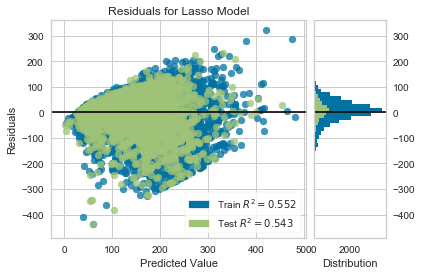

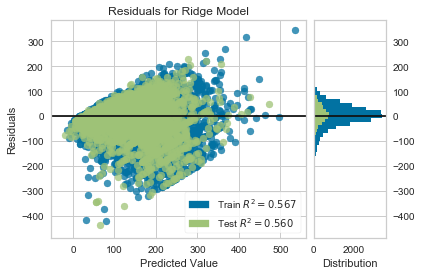

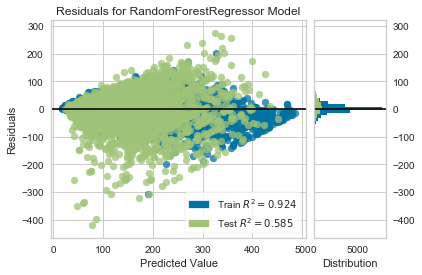

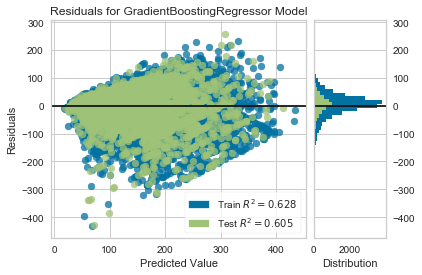

In [8]:
regressors = {
    'lasso': Lasso(),
    'ridge': Ridge(),
    'random_forest': RandomForestRegressor(),
    'gradient_boost': GradientBoostingRegressor(),
}

for _, regressor in regressors.items():
    visualizer = ResidualsPlot(regressor)
    visualizer.fit(X_train, y_train)
    visualizer.score(X_test, y_test)
    visualizer.show()

# Lasso Regression

In [7]:
#hyper parameters
regressor = Lasso()

alphas = [0.001, 0.01, 0.1, 1, 10, 100, 1000]
tuned_params = [{'alpha': alphas}]
n_folds = 10

grid = GridSearchCV(regressor, tuned_params, cv=10)

grid.fit(X_train, y_train)
print(grid.best_estimator_)

Lasso(alpha=0.001, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False)


In [8]:
#using CV with best alpha
regressor = Lasso(alpha=0.01)
regressor = regressor.fit(X_train, y_train) 

#cross validation, 10 fold to try next
scores = cross_val_score(estimator=regressor, X=X_train, y=y_train, cv=10, scoring="neg_mean_squared_error")
rmse_scores = np.sqrt(-scores)

print(rmse_scores)


[53.58883573 54.70587584 57.37725791 56.61396002 54.26953047 52.99116619
 54.65500798 53.06729958 55.34676239 52.44331298]


In [9]:
pred_train = regressor.predict(X_train)
print(rmse_scores.mean())
print(r2_score(y_train, pred_train))


54.50590091020024
0.56722146371269


In [10]:
pred_test= regressor.predict(X_test)
print(np.sqrt(mean_squared_error(y_test,pred_test))) 
print(r2_score(y_test, pred_test))

55.751923915151565
0.559991302085981


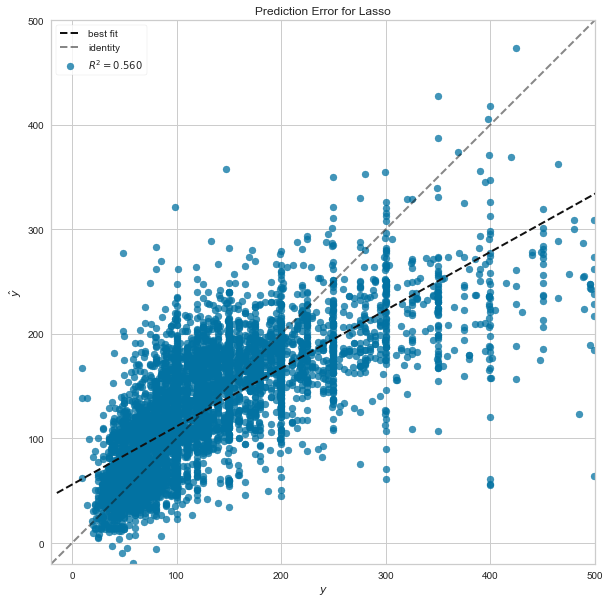

In [11]:
# Instantiate the linear model and visualizer
visualizer = PredictionError(regressor, size=(1080, 720))

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()                 # Draw the data

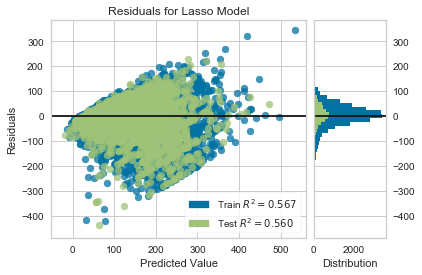

In [12]:
#chart
oz = ResidualsPlot(regressor)

oz.fit(X_train, y_train)
oz.score(X_test, y_test)
_ = oz.show()

# Ridge Regression

In [13]:
#hyper parameters
regressor = Ridge()

alphas = [0.001, 0.01, 0.1, 1, 10, 100, 1000]
tuned_params = [{'alpha': alphas}]
n_folds = 10

grid = GridSearchCV(regressor, tuned_params, cv=10)

grid.fit(X_train, y_train)
print(grid.best_estimator_)

Ridge(alpha=10, copy_X=True, fit_intercept=True, max_iter=None, normalize=False,
      random_state=None, solver='auto', tol=0.001)


In [14]:
#using CV
regressor = Ridge(alpha=10)
regressor = regressor.fit(X_train, y_train) 

#cross validation
scores = cross_val_score(estimator=regressor, X=X_train, y=y_train, cv=10, scoring="neg_mean_squared_error")
rmse_scores = np.sqrt(-scores)
print(rmse_scores)


[53.58874747 54.70420864 57.37177653 56.61587074 54.26716294 52.99115977
 54.65845098 53.06989654 55.34672412 52.43947677]


In [15]:
pred_train = regressor.predict(X_train)
print(rmse_scores.mean())
print(r2_score(y_train, pred_train))


54.50534744898264
0.56723110149997


In [16]:
pred_test= regressor.predict(X_test)
print(np.sqrt(mean_squared_error(y_test,pred_test))) 
print(r2_score(y_test, pred_test))

55.75468458193152
0.5599477252052392


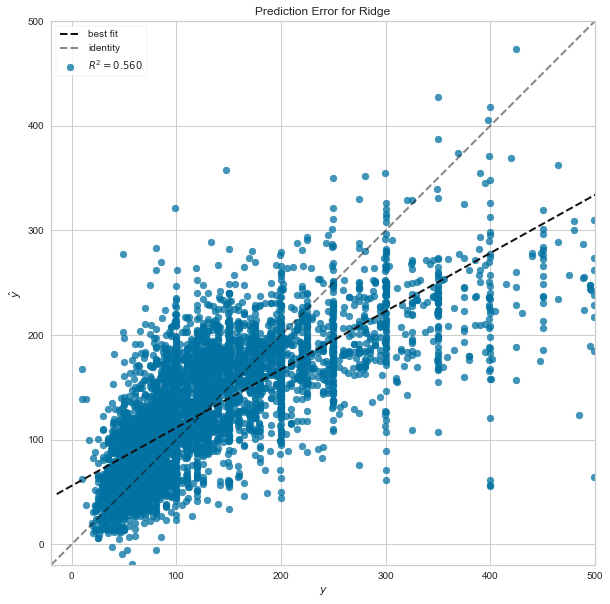

In [17]:
# Instantiate the linear model and visualizer
visualizer = PredictionError(regressor, size=(1080, 720))

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()                 # Draw the data

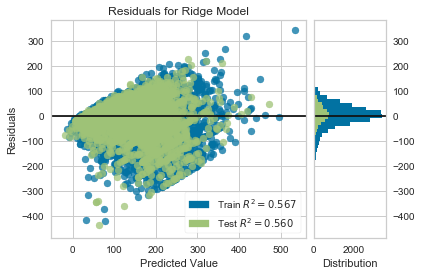

In [18]:
#chart
oz = ResidualsPlot(regressor)

oz.fit(X_train, y_train)
oz.score(X_test, y_test)
_ = oz.show()

# Random Forest

In [24]:
#hyper parameters
regressor = RandomForestRegressor()

n_estimators = [10,100]
min_samples_split = [100,110,120,130,140,150,200,300]
tuned_params = [{'n_estimators': n_estimators, 'min_samples_split': min_samples_split}]
n_folds = 10

grid = GridSearchCV(regressor, tuned_params, cv=10)

grid.fit(X_train, y_train)
print(grid.best_estimator_)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=100,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=None,
                      verbose=0, warm_start=False)


In [25]:
#using CV and best parameters from the grid
regressor = RandomForestRegressor(n_estimators=100, random_state=None, min_samples_split=100)
regressor = regressor.fit(X_train, y_train) 

#cross validation
scores = cross_val_score(estimator=regressor, X=X_train, y=y_train, cv=10, scoring="neg_mean_squared_error")
rmse_scores = np.sqrt(-scores) 
print(rmse_scores)

[50.19834399 52.08376441 53.70265072 54.13108806 51.38854658 51.65360486
 52.8270352  50.37964427 52.18121109 51.04883179]


In [27]:
pred_train= regressor.predict(X_train)
print(rmse_scores.mean())
print(r2_score(y_train, pred_train))

51.95947209528215
0.6699603610567645


In [26]:
pred_test= regressor.predict(X_test)
print(np.sqrt(mean_squared_error(y_test,pred_test))) 
print(r2_score(y_test, pred_test))

52.650455406007204
0.6075848120196399


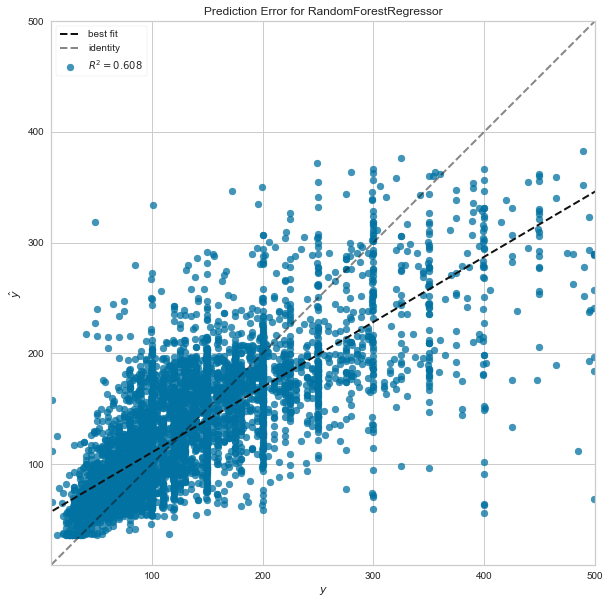

In [28]:
# Instantiate the linear model and visualizer
visualizer = PredictionError(regressor, size=(1080, 720))

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()                 # Draw the data

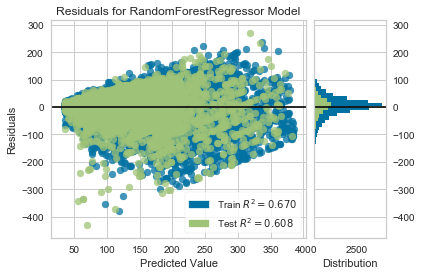

In [29]:
#chart
oz = ResidualsPlot(regressor)

oz.fit(X_train, y_train)
oz.score(X_test, y_test)
_ = oz.show()

# Gradient Boost

In [39]:
#hyper parameters
regressor = GradientBoostingRegressor()

n_estimators = [100,150,200]
max_depth = [2,3,4,5,6,7]
tuned_params = [{'max_depth': max_depth, 'n_estimators': n_estimators}]
n_folds = 10

grid = GridSearchCV(regressor, tuned_params, cv=10)

grid.fit(X_train, y_train)
print(grid.best_estimator_)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
                          learning_rate=0.1, loss='ls', max_depth=6,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=100,
                          n_iter_no_change=None, presort='auto',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)


In [40]:
#using CV, use best parameter from the grid
regressor = GradientBoostingRegressor(max_depth=6)
regressor = regressor.fit(X_train, y_train) 

#cross validation
scores = cross_val_score(estimator=regressor, X=X_train, y=y_train, cv=10, scoring="neg_mean_squared_error")
rmse_scores = np.sqrt(-scores) 
print(rmse_scores)

[48.58866955 50.87080077 52.24320568 52.29342195 49.15572344 50.70504521
 51.89587631 49.08143982 50.94340601 49.18560097]


In [41]:
pred_train= regressor.predict(X_train)
print(rmse_scores.mean())
print(r2_score(y_train, pred_train))

50.49631897216386
0.7286723374526136


In [42]:
pred_test= regressor.predict(X_test)
print(np.sqrt(mean_squared_error(y_test,pred_test))) 
print(r2_score(y_test, pred_test))

51.80314863650973
0.6201135016127254


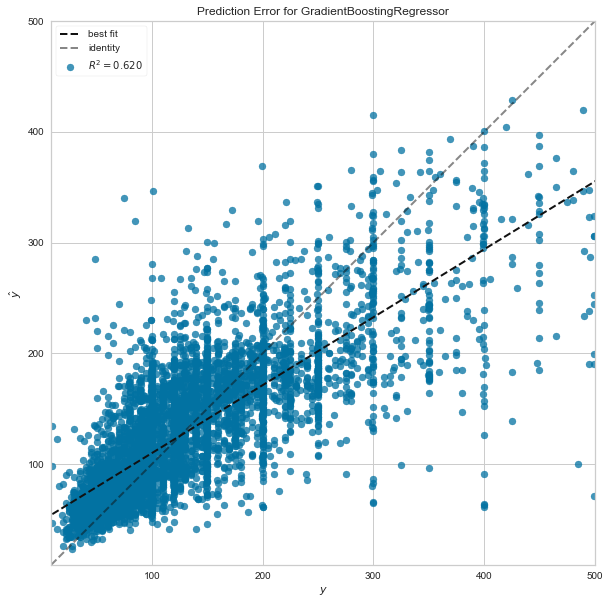

In [43]:
# Instantiate the linear model and visualizer
visualizer = PredictionError(regressor, size=(1080, 720))

visualizer.fit(X_train, y_train)  # Fit the training data to the visualizer
visualizer.score(X_test, y_test)  # Evaluate the model on the test data
visualizer.show()                 # Draw the data

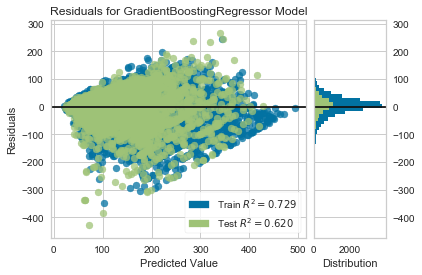

In [44]:
#chart
oz = ResidualsPlot(regressor)

oz.fit(X_train, y_train)
oz.score(X_test, y_test)
_ = oz.show()

# Feature Importance
this was for gradient boosting - run the same code for random forest, make sure run the fit/model first, it uses same regessor variable

In [16]:
#get features importance
features = regressor.feature_importances_

#get column names from our list of features
column_names=X.columns.values.tolist()

#match features importance to column name
df = pd.DataFrame([features], columns=column_names)


In [17]:
df.head()

,host_since,host_is_superhost,host_identity_verified,is_location_exact,accommodates,bathrooms,bedrooms,beds,security_deposit_yes_no,cleaning_fee_yes_no,...,real_bed_yes_no,multiple_listings,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,cancellation_policy_calc_flexible,cancellation_policy_calc_moderate,cancellation_policy_calc_strict,last_review_days_ago
0,0.007597,0.000978,0.000032,0.000279,0.116682,0.071286,0.105245,0.001374,0.001192,0.000425,...,0.00012,5.015553e-07,0.487576,0.0,0.000681,0.001878,0.0,0.00038,0.003043,0.004125


In [19]:
#features importance sorted
features_sorted = df.iloc[0].sort_values(ascending=False)

In [20]:
features_sorted.head(60)


room_type_Entire home/apt                     4.875764e-01
neighbourhood_group_cleansed_Manhattan        1.324564e-01
accommodates                                  1.166815e-01
bedrooms                                      1.052455e-01
bathrooms                                     7.128624e-02
guests_included                               1.898442e-02
reviews_per_month                             9.325469e-03
host_since                                    7.596594e-03
review_scores_cleanliness                     6.480455e-03
amenities_count                               5.548949e-03
extra_people_yes_no                           5.041750e-03
neighbourhood_group_cleansed_Queens           4.782731e-03
last_review_days_ago                          4.124901e-03
cancellation_policy_calc_strict               3.042908e-03
apt_yes_no                                    2.963803e-03
number_of_reviews                             2.858385e-03
neighbourhood_group_cleansed_Brooklyn         2.400368e-

# Using Yellowbrick to visualize

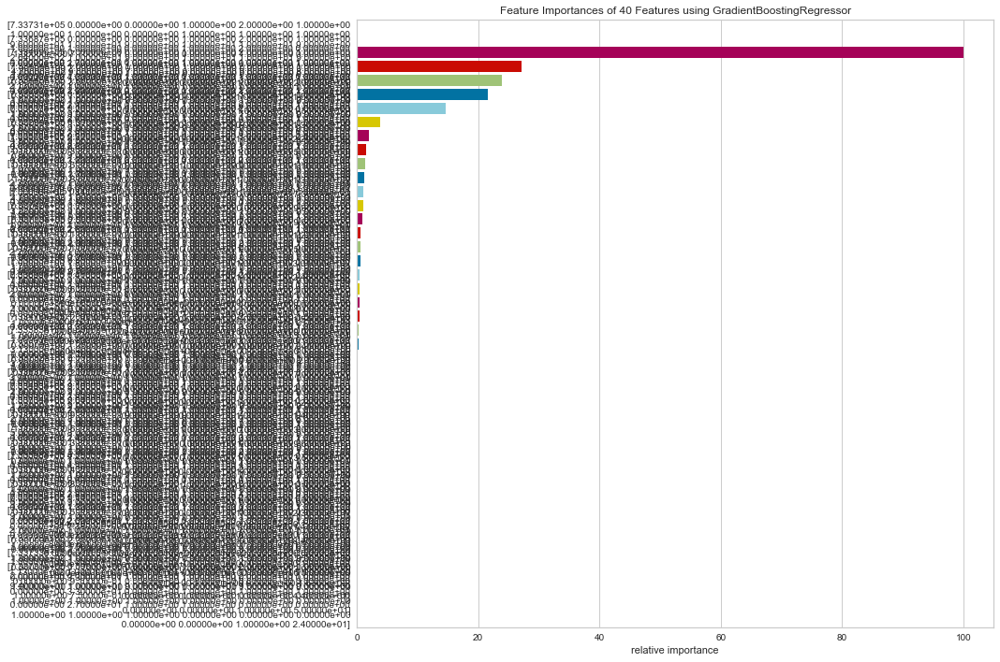

In [24]:
model = GradientBoostingRegressor(random_state=0)
viz = FeatureImportances(model, labels=X, size=(1080, 720))

viz.fit(X_train, y_train)
# Note: the FeatureImportances visualizer is a model visualizer,
# not a feature visualizer, so it doesn't have a transform method!
viz.show()

# Model Output for Testing Flask
Using very few features

In [3]:
X = listings[['room_type_Entire home/apt',
            'neighbourhood_group_cleansed_Manhattan',
            'accommodates',
            'bedrooms',
            'bathrooms',
            'guests_included']]

y = listings['price']

# Split your data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Gradient Boost
For testing flask

In [4]:
#using CV
# regressor = Lasso(alpha=0.1)
# regressor = regressor.fit(X_train, y_train) 

#using CV
regressor = GradientBoostingRegressor(random_state=0)
regressor = regressor.fit(X_train, y_train) 

#cross validation, 10 fold to try next
scores = cross_val_score(estimator=regressor, X=X_train, y=y_train, cv=10, scoring="neg_mean_squared_error")
rmse_scores = np.sqrt(-scores)

print(rmse_scores)

[52.24485164 54.15035709 55.86316481 55.97613252 52.83969573 52.70558872
 53.83794419 51.9479324  54.23666047 52.06170319]


In [5]:
pred_train = regressor.predict(X_train)
print(rmse_scores.mean())
print(r2_score(y_train, pred_train))

53.586403075900456
0.5904922882175974


In [6]:
pred_test= regressor.predict(X_test)
print(np.sqrt(mean_squared_error(y_test,pred_test))) 
print(r2_score(y_test, pred_test))

54.628583085502896
0.5775440644295136


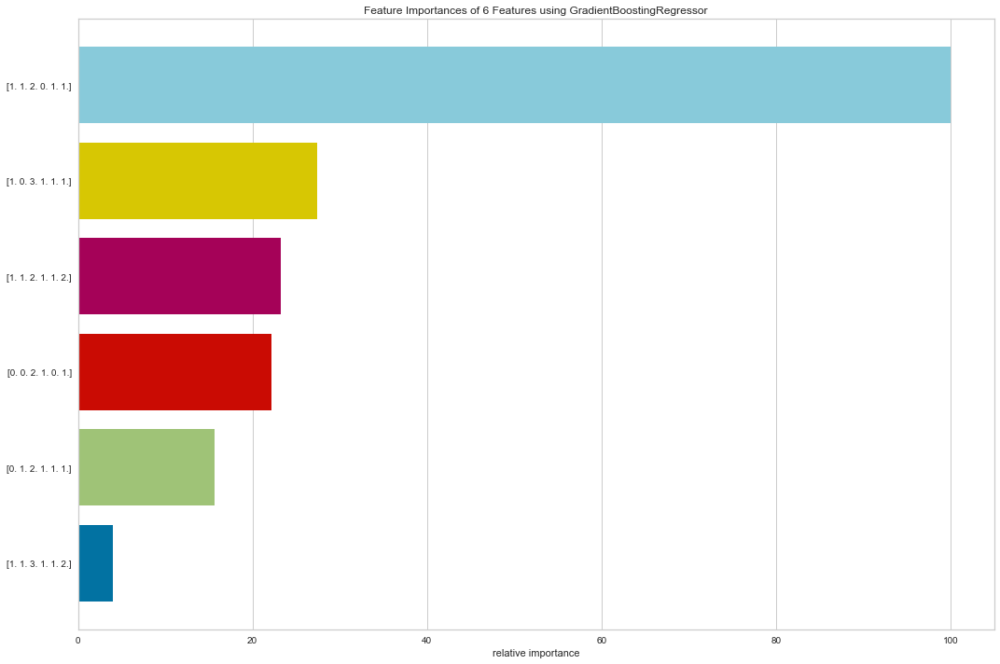

In [7]:
model = regressor = GradientBoostingRegressor(random_state=0)
viz = FeatureImportances(model, labels=X, size=(1080, 720))

viz.fit(X_train, y_train)
# Note: the FeatureImportances visualizer is a model visualizer,
# not a feature visualizer, so it doesn't have a transform method!
viz.show()

In [12]:
# Saving model to disk
pickle.dump(regressor, open('model.pkl','wb'))

# Webapp

In [31]:
%%HTML

'<iframe width="700" height="600" src="http://seebeyond.pythonanywhere.com" frameborder="0" allowfullscreen></iframe>'
